In [2]:
import pandas as pd

In [3]:
patches = pd.read_csv('patches.csv', header=None)
patches.columns = ['tick', 'pID', 'properties', 'occupied', 'density', 'zID', 'nID', 'p-age', 'psize', 'ptype', 'price', 'PR', 'CR', 'Rent-gap', 'pcolor']

In [4]:
patches.shape

(6383358, 15)

In [5]:
patches.head()

,tick,pID,properties,occupied,density,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor
0,0,19517,0,False,0.086705,90.0,40.0,58,1538.325460,S,165098.550768,1474.870240,144.940787,0.901726,3.0
1,0,18418,0,False,0.000000,30.0,4.0,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0
2,0,5492,0,False,0.135246,90.0,67.0,36,2500.057538,S,578360.583731,2041.498838,483.687744,0.763072,3.0
3,0,39588,0,False,0.000000,NaN,NaN,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0
4,0,2126,0,False,0.000000,NaN,NaN,0,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.0


In [6]:
patches.tail()

,tick,pID,properties,occupied,density,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor
6383353,157,10338,0,False,0.353698,60.0,99.0,21,896.765840,C,8.151679e+05,1269.253636,547.950152,0.568289,3.0
6383354,157,34656,0,False,0.115385,90.0,32.0,12,1008.064873,S,1.126757e+06,1553.401942,961.219323,0.381217,115.0
6383355,157,3104,0,False,0.101911,90.0,66.0,46,692.729970,S,4.775063e+05,2599.708241,412.878971,0.841183,115.0
6383356,157,24126,0,False,0.000000,NaN,NaN,0,0.000000,0,0.000000e+00,0.000000,0.000000,0.000000,0.0
6383357,157,35374,0,False,0.000000,NaN,NaN,0,0.000000,0,0.000000e+00,0.000000,0.000000,0.000000,0.0


In [7]:
turtles = pd.read_csv('turtles.csv', header=None)
turtles.columns = ['tick', 'tID', 'budget', 'ttype', 'income', 'housing', 'saving', 'lowerbound', 'upperbound', 'happy', 'pID', 'similar-color', 'similar-income', 'NOI', 'near-CBD', 'low-rent']

In [8]:
turtles.shape

(681116, 16)

In [9]:
turtles.head()

,tick,tID,budget,ttype,income,housing,saving,lowerbound,upperbound,happy,pID,similar-color,similar-income,NOI,near-CBD,low-rent
0,0,862,102991.108022,pro,149262.475395,-705597.582159,138814.102117,117086,158542,false,2735,0,0,0.0,0,0
1,0,2065,39948.806481,nonpro,57896.820987,-438193.876097,53844.043518,31876,53752,false,28624,0,0,0.0,1,0
2,0,965,94986.503029,pro,137661.598593,-416707.841637,128025.286691,117086,158542,false,27674,0,0,0.0,1,0
3,0,971,110109.779976,pro,159579.391269,-944683.415072,148408.833880,117086,158542,false,21487,1,0,0.0,1,0
4,0,2217,26050.100238,nonpro,37753.768461,352069.788947,35111.004668,31876,53752,false,12977,1,0,0.0,1,1


In [10]:
#turtles[(turtles['tID']==623)][['tick','pID']]

In [11]:
merged = turtles.merge(patches, on=['pID','tick'])

In [12]:
#merged[(merged['tID']==623)][['tick','pID','nID']]

In [13]:
from collections import defaultdict

In [14]:
group = merged.groupby('tID')

In [15]:
# nonpros that have moved to zID 60 neighborhoods from any neighborhood in any zID in every tick
nonpros_per_tick = {}
for key, g in group:
    #print(key, g['ttype'].values[0])
    nIDs = g['nID'].values
    moved = [t+1 for t,(i,j) in enumerate(zip(nIDs, nIDs[1:])) if i!=j]
    #print('nID', nIDs)
    #print(moved)
    if g['ttype'].values[0] == 'nonpro' and g['zID'].values[0]==60:
        for tick in moved:
            if tick in nonpros_per_tick:
                nonpros_per_tick[tick]+=1
            else:
                nonpros_per_tick[tick]=1
    #print('zID', g['zID'].values)
    #print('**************************************')

In [16]:
# sorting based on tick
nonpros_per_tick = sorted(nonpros_per_tick.items(), key=lambda x: x[0])

In [17]:
#nonpros and pros who have interest to live near CBD and pay low rent
nonpros = []
pros = []
group = merged.groupby('tick')
for key, g in group:
    nonpro, pro = g[(g['near-CBD']==1) & (g['low-rent']==1)]['ttype'].value_counts().values
    #print('key: {}, number of nonpros: {}, number of pros: {}'.format(key, nonpro, pro))
    nonpros.append(nonpro)
    pros.append(pro)

# Gentrification by Demand

In [18]:
import matplotlib.pylab as plt
import numpy as np
import os

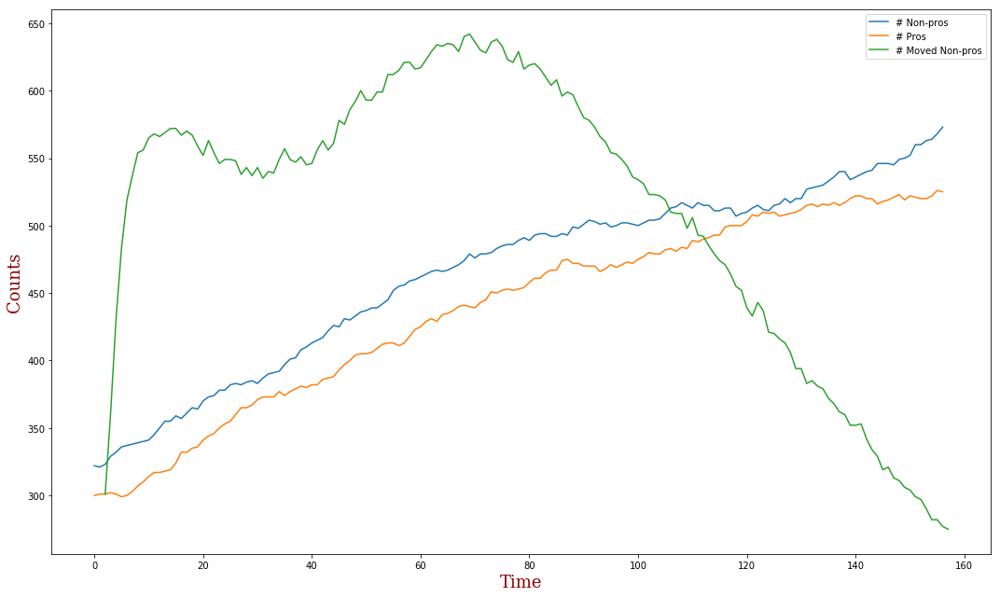

In [19]:
font = {'family': 'serif',
        'color':  'darkred',
        'weight': 'normal',
        'size': 18,
        }
n = len(nonpros)
fig = plt.figure(figsize=(15,9))
ax = fig.add_subplot(1,1,1)
# pros and nonpros population for near CBD and low rent
ax.plot(range(n-1), nonpros[1:])
ax.plot(range(n-1), pros[1:])
# moved nonpros
ax.plot([_[0] for _ in nonpros_per_tick][1:], [_[1] for _ in nonpros_per_tick][1:])
ax.legend(['# Non-pros', '# Pros', '# Moved Non-pros'])
ax.set_xlabel('Time',fontdict=font)
ax.set_ylabel('Counts',fontdict=font)

plt.tight_layout()
plt.show()

In [20]:
merged.head()

,tick,tID,budget,ttype,income,housing,saving,lowerbound,upperbound,happy,...,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor
0,0,862,102991.108022,pro,149262.475395,-705597.582159,138814.102117,117086,158542,false,...,90.0,27.0,69,2048.579213,S,153045.887770,1958.423400,123.952080,0.936708,3.0
1,0,2065,39948.806481,nonpro,57896.820987,-438193.876097,53844.043518,31876,53752,false,...,60.0,127.0,50,933.866212,C,190888.431898,1227.750556,166.157969,0.864665,3.0
2,0,965,94986.503029,pro,137661.598593,-416707.841637,128025.286691,117086,158542,false,...,60.0,97.0,70,973.915468,C,92082.448605,1292.152051,78.575847,0.939190,3.0
3,0,971,110109.779976,pro,159579.391269,-944683.415072,148408.833880,117086,158542,false,...,90.0,71.0,56,1466.938844,S,328596.901251,2564.326589,272.994373,0.893541,3.0
4,0,2217,26050.100238,nonpro,37753.768461,352069.788947,35111.004668,31876,53752,false,...,60.0,98.0,69,947.709836,C,88798.708769,1170.843653,74.104765,0.936708,3.0


In [21]:
merged.columns

Index(['tick', 'tID', 'budget', 'ttype', 'income', 'housing', 'saving',
       'lowerbound', 'upperbound', 'happy', 'pID', 'similar-color',
       'similar-income', 'NOI', 'near-CBD', 'low-rent', 'properties',
       'occupied', 'density', 'zID', 'nID', 'p-age', 'psize', 'ptype', 'price',
       'PR', 'CR', 'Rent-gap', 'pcolor'],
      dtype='object')

In [22]:
group = merged.groupby(['nID', 'tick'])

In [23]:
# nonpros that have moved to zID 60 neighborhoods from any neighborhood in any zID in every tick
stat_nonpro = defaultdict(list)
stat_pro = defaultdict(list)
patch_info = defaultdict(list)
for (key,tick), g in group:
    nonpros = g[g.ttype=='nonpro']
    pros = g[g.ttype=='pro']
    nnonpros = nonpros.shape[0]
    npros = pros.shape[0]
    nonpros_happy = dict(zip(nonpros.happy.value_counts().keys(), nonpros.happy.value_counts().values))
    pros_happy = dict(zip(pros.happy.value_counts().keys(), pros.happy.value_counts().values))
    stat_nonpro[key].append({'tick':tick, 
                             'avg_savings':nonpros['housing'].mean(), 
                             'counts': nonpros.shape[0],
                            'nhappy': nonpros_happy['true'] if 'true' in nonpros_happy else 0,
                            'percentage_happy': float(nonpros_happy['true'])/nnonpros if 'true' in nonpros_happy else 0})
    stat_pro[key].append({'tick':tick, 
                          'avg_savings':pros['housing'].mean(), 
                          'counts': pros.shape[0],
                        'nhappy': pros_happy['true'] if 'true' in pros_happy else 0,
                        'percentage_happy': float(pros_happy['true'])/npros if 'true' in pros_happy else 0})
    patch_info[key].append({'tick':tick, 'housing_price':g.price.mean(), 'density':g.density.values[0]})

# Gentrification by Supply

### All patches that are developed by a developer

In [24]:
dev_patches = patches[(patches.occupied == False) & (patches['p-age']==1) & (patches['tick']>0) & (patches['pcolor']!=3)]

In [25]:
dev_patches.head()

,tick,pID,properties,occupied,density,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor
40438,1,5358,0,False,0.086580,90.0,74.0,1,1221.060175,S,1.851896e+06,1692.349781,1625.991796,0.039211,45.0
40512,1,6475,0,False,0.136719,90.0,64.0,1,1763.257716,S,1.723160e+06,1497.697894,1438.972320,0.039211,5.0
41077,1,7522,0,False,0.107784,90.0,46.0,1,1902.932280,S,2.335257e+06,2089.292310,2007.369986,0.039211,115.0
41096,1,21929,0,False,0.128492,90.0,19.0,1,1622.938455,S,3.071351e+06,2691.541168,2586.004329,0.039211,115.0
41195,1,34690,0,False,0.118343,90.0,25.0,1,2025.373136,S,2.181184e+06,1930.951020,1855.237348,0.039211,45.0


In [26]:
mgroup = merged.groupby('nID')
dgroup = dev_patches.groupby('nID')

pros_bought_house = {}
nonpros_bought_house = {}
pros_bought_house_by_nid = {}
nonpros_bought_house_by_nid = {}

for nid, g in dgroup:
    for pid in set(g.pID.values):
        renovated_years_ticks = g[(g.pID==pid)]['tick'].values
        owned_by_agent_ticks = merged[merged.pID == pid]['tick'].values
        agent_at_pid = merged[merged.pID == pid]
        if len(owned_by_agent_ticks)==0: continue
        moved = [owned_by_agent_ticks[0]]+[j for (i,j) in zip(owned_by_agent_ticks, owned_by_agent_ticks[1:]) if (i+1)!=j]
        #print(nid, pid)
        #print(renovated_years_ticks)
        #print(owned_by_agent_ticks)
        #print(moved)
        i = 0
        for ry in renovated_years_ticks:
            #print('ry', ry)
            while i<len(owned_by_agent_ticks) and owned_by_agent_ticks[i]<ry: i+=1
            if i<len(owned_by_agent_ticks):
                agent_type = agent_at_pid[agent_at_pid['tick']==owned_by_agent_ticks[i]]['ttype'].values[0] # pro/nonpro
                #print('developed at {} owned by agent {} at {}'.format(ry, agent_type, owned_by_agent_ticks[i]))
                if agent_type == 'pro':
                    if owned_by_agent_ticks[i] in pros_bought_house:
                        pros_bought_house[owned_by_agent_ticks[i]]+=1
                    else:
                        pros_bought_house[owned_by_agent_ticks[i]]=1
                    if nid in pros_bought_house_by_nid:
                        if owned_by_agent_ticks[i] in pros_bought_house_by_nid[nid]:
                            pros_bought_house_by_nid[nid][owned_by_agent_ticks[i]]+=1
                        else:
                            pros_bought_house_by_nid[nid][owned_by_agent_ticks[i]]=1
                    else:
                        pros_bought_house_by_nid[nid] = {owned_by_agent_ticks[i]:1}
                else:
                    if owned_by_agent_ticks[i] in nonpros_bought_house:
                        nonpros_bought_house[owned_by_agent_ticks[i]]+=1
                    else:
                        nonpros_bought_house[owned_by_agent_ticks[i]]=1
                    if nid in nonpros_bought_house_by_nid:
                        if owned_by_agent_ticks[i] in nonpros_bought_house_by_nid[nid]:
                            nonpros_bought_house_by_nid[nid][owned_by_agent_ticks[i]]+=1
                        else:
                            nonpros_bought_house_by_nid[nid][owned_by_agent_ticks[i]]=1
                    else:
                        nonpros_bought_house_by_nid[nid] = {owned_by_agent_ticks[i]:1}


In [27]:
'''
group = merged.groupby('nID')
pros_bought_house = {}
nonpros_bought_house = {}
pros_bought_house_by_nid = {}
nonpros_bought_house_by_nid = {}

for key, g in group:
    for pid in set(g.pID.values):
        renovated_years = sorted(g[(g.pID==pid) & (g['p-age']==1)]['tick'].values)
        bought_by_agent = sorted(g[(g.pID==pid) & (g['pcolor']==3)]['tick'].values)
        i = 0
        for ry in renovated_years:
            while i<len(bought_by_agent) and bought_by_agent[i]<ry: i+=1
            if i<len(bought_by_agent):
                agent_type = g[(g.pID==pid) & (g['tick']==bought_by_agent[i])]['ttype'].values[0] # pro/nonpro
                if agent_type == 'pro':
                    if bought_by_agent[i] in pros:
                        pros_bought_house[bought_by_agent[i]]+=1
                    else:
                        pros_bought_house[bought_by_agent[i]]=1
                    if key in pros_bought_house_by_nid:
                        if bought_by_agent[i] in pros_bought_house_by_nid[key]:
                            pros_bought_house_by_nid[key][bought_by_agent[i]]+=1
                        else:
                            pros_bought_house_by_nid[key][bought_by_agent[i]]=1
                    else:
                        pros_bought_house_by_nid[key] = {bought_by_agent[i]:1}
                else:
                    if bought_by_agent[i] in nonpros:
                        nonpros_bought_house[bought_by_agent[i]]+=1
                    else:
                        nonpros_bought_house[bought_by_agent[i]]=1
                    if key in nonpros_bought_house_by_nid:
                        if bought_by_agent[i] in nonpros_bought_house_by_nid[key]:
                            nonpros_bought_house_by_nid[key][bought_by_agent[i]]+=1
                        else:
                            nonpros_bought_house_by_nid[key][bought_by_agent[i]]=1
                    else:
                        nonpros_bought_house_by_nid[key] = {bought_by_agent[i]:1}
'''
print()

In [28]:
z = pd.DataFrame(merged['p-age'].value_counts()).reset_index()
z.columns = ['age', 'count']
z[z.age==0]

,age,count
190,0,711


In [29]:
#merged[merged['p-age']==1]
z = pd.DataFrame(patches[(patches.pcolor==3) & (patches.occupied == False)]['p-age'].value_counts()).reset_index()
z.columns = ['age', 'count']
z[z.age==1]

,age,count
98,1,219


In [30]:
# all patches that are developed by a developer with their pIDs
patches[(patches.occupied == False) & (patches['p-age']==1) & (patches['tick']>0) & (patches['pcolor']!=3)][['tick','p-age','nID', 'pID', 'pcolor']].head()

,tick,p-age,nID,pID,pcolor
40438,1,1,74.0,5358,45.0
40512,1,1,64.0,6475,5.0
41077,1,1,46.0,7522,115.0
41096,1,1,19.0,21929,115.0
41195,1,1,25.0,34690,45.0


In [31]:
# Example of a patch that has been developed by a developer, 
# this one was developed at tick 1 and bought by some agent at time 56
patches[(patches.pcolor==3) & (patches['pID']==9174)][['tick','p-age','nID', 'pID', 'pcolor', 'occupied']]

,tick,p-age,nID,pID,pcolor,occupied
30440,0,100,72.0,9174,3.0,False
3532321,87,87,72.0,9174,3.0,False
3588308,88,88,72.0,9174,3.0,False
3619310,89,89,72.0,9174,3.0,False
3645269,90,90,72.0,9174,3.0,False
3708809,91,91,72.0,9174,3.0,False
3744938,92,92,72.0,9174,3.0,False
3788188,93,93,72.0,9174,3.0,False
3821157,94,94,72.0,9174,3.0,False
3861084,95,95,72.0,9174,3.0,False


In [32]:
merged[merged.pID == 9174]

,tick,tID,budget,ttype,income,housing,saving,lowerbound,upperbound,happy,...,zID,nID,p-age,psize,ptype,price,PR,CR,Rent-gap,pcolor


In [33]:
print(pros_bought_house)
print(nonpros_bought_house)
print(pros_bought_house_by_nid)
print(nonpros_bought_house_by_nid)

{62: 209, 52: 170, 82: 224, 98: 212, 79: 199, 73: 196, 70: 192, 144: 193, 36: 103, 114: 210, 141: 195, 154: 230, 85: 209, 71: 176, 97: 200, 55: 181, 118: 210, 69: 189, 139: 203, 81: 197, 30: 51, 123: 185, 107: 209, 92: 213, 101: 218, 130: 206, 68: 210, 18: 8, 25: 35, 119: 205, 33: 75, 83: 202, 53: 180, 143: 198, 49: 164, 47: 155, 80: 227, 152: 196, 157: 190, 78: 205, 84: 212, 42: 132, 28: 57, 48: 164, 149: 227, 51: 176, 135: 201, 61: 190, 113: 207, 35: 88, 117: 218, 59: 183, 58: 181, 63: 196, 89: 220, 95: 192, 106: 204, 40: 119, 121: 202, 66: 175, 110: 208, 86: 217, 94: 219, 34: 78, 91: 218, 90: 225, 102: 221, 75: 201, 41: 117, 56: 193, 142: 227, 100: 215, 31: 55, 150: 205, 138: 186, 65: 199, 87: 192, 26: 29, 112: 193, 124: 211, 108: 199, 39: 109, 126: 200, 37: 94, 43: 133, 111: 201, 147: 197, 133: 214, 38: 110, 127: 208, 60: 177, 148: 197, 67: 184, 156: 192, 125: 210, 29: 41, 44: 123, 54: 184, 74: 213, 93: 213, 50: 156, 105: 232, 104: 220, 77: 209, 140: 226, 122: 186, 64: 186, 19: 15,

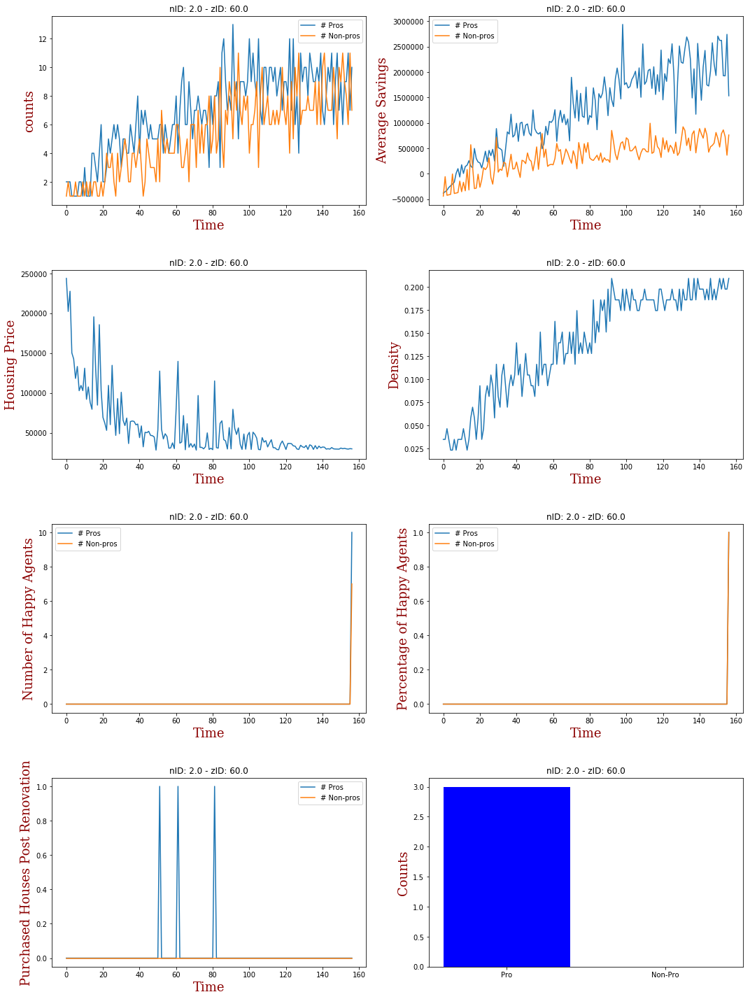

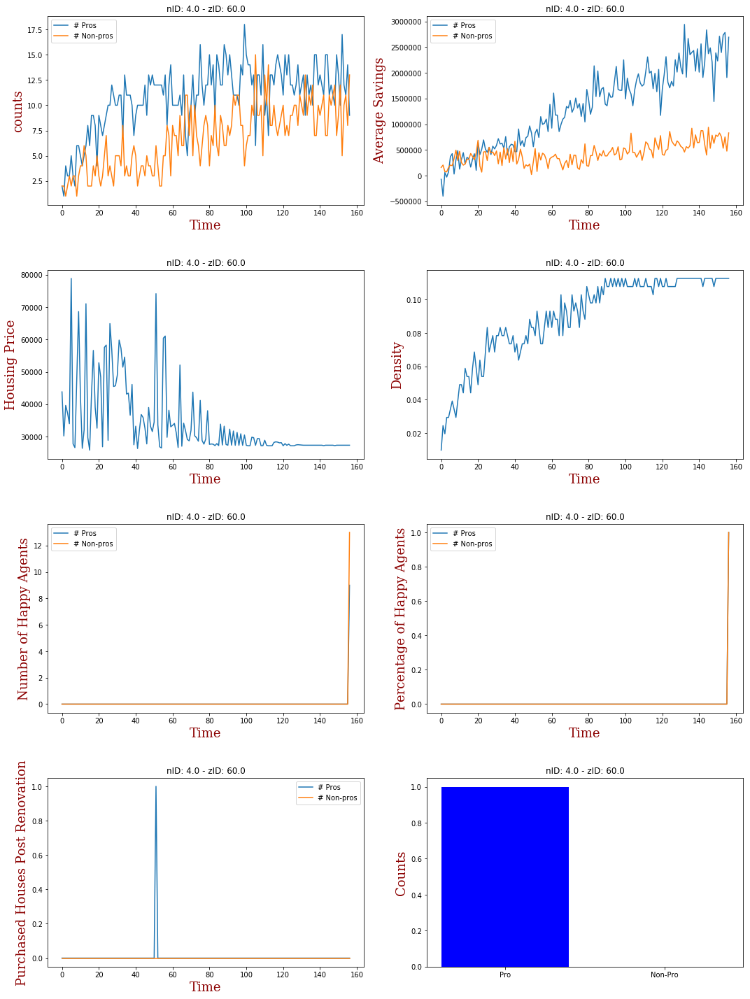

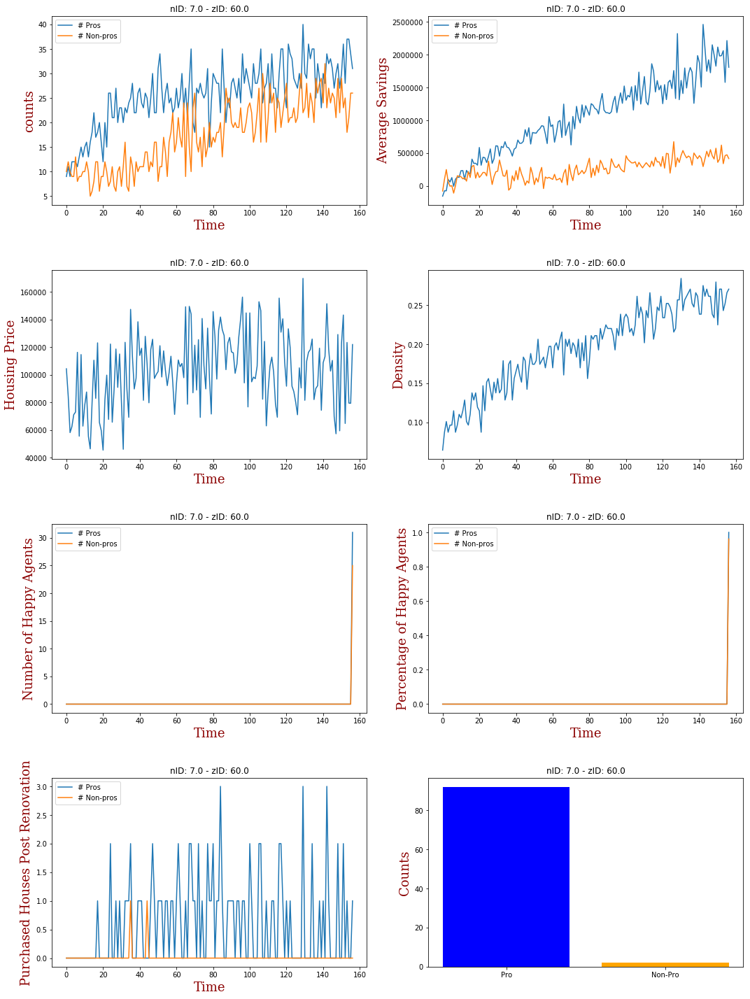

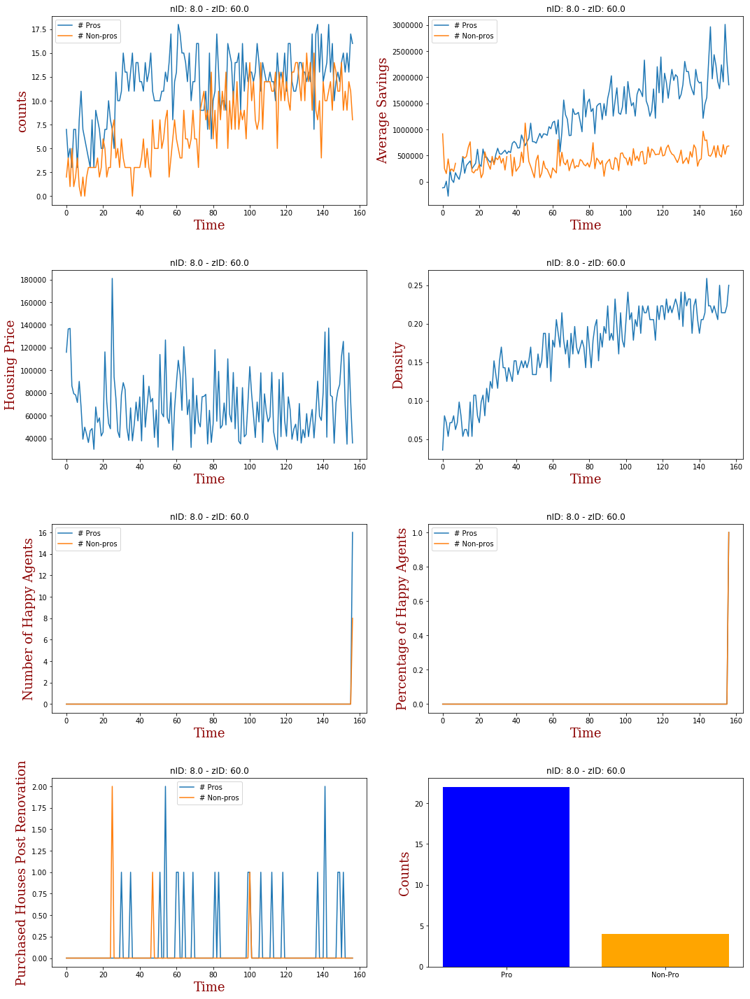

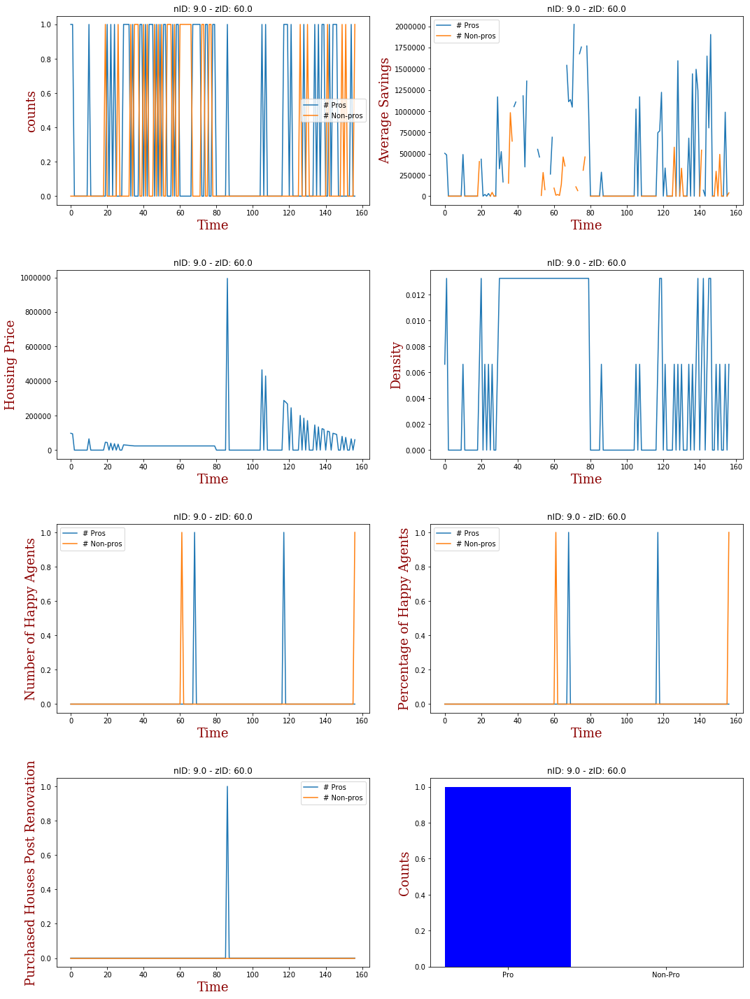

...

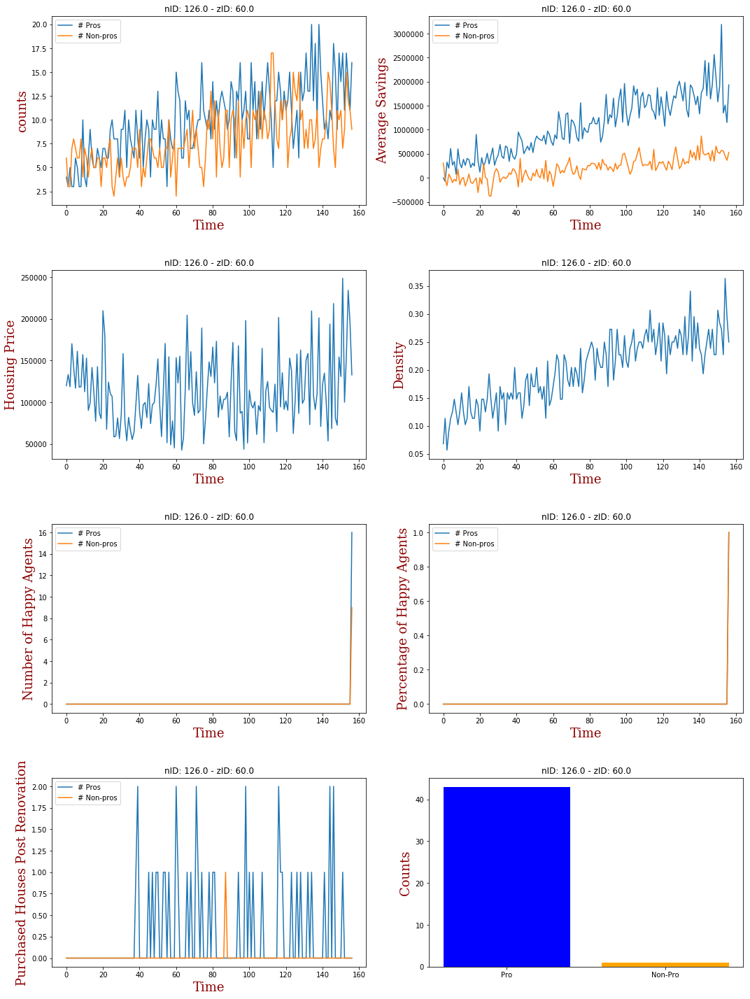

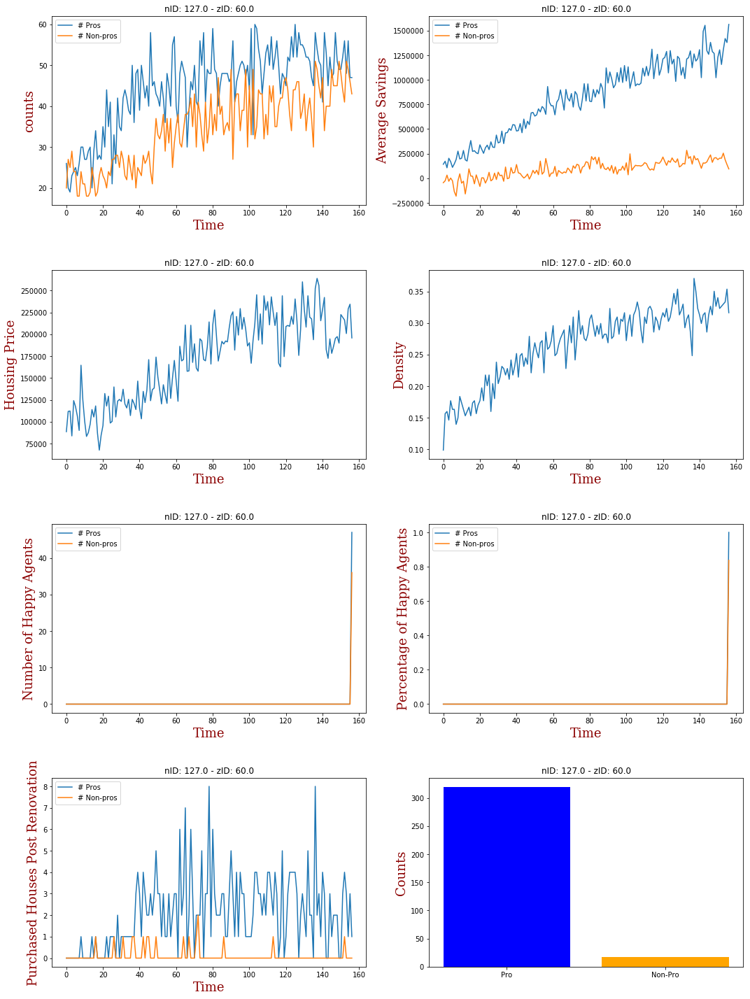

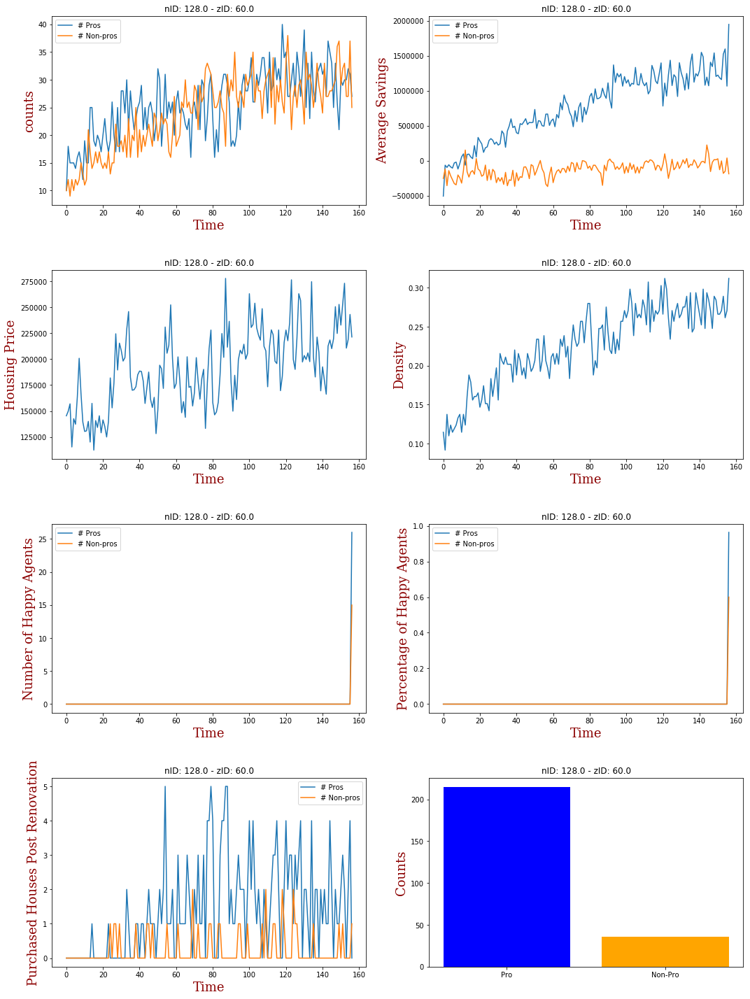

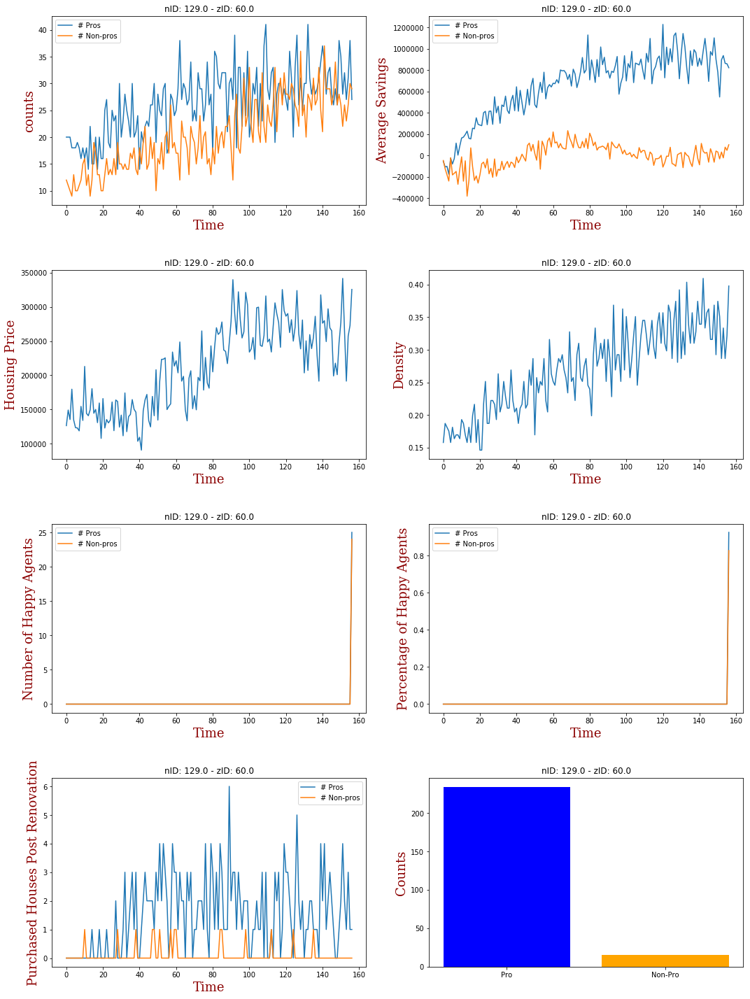

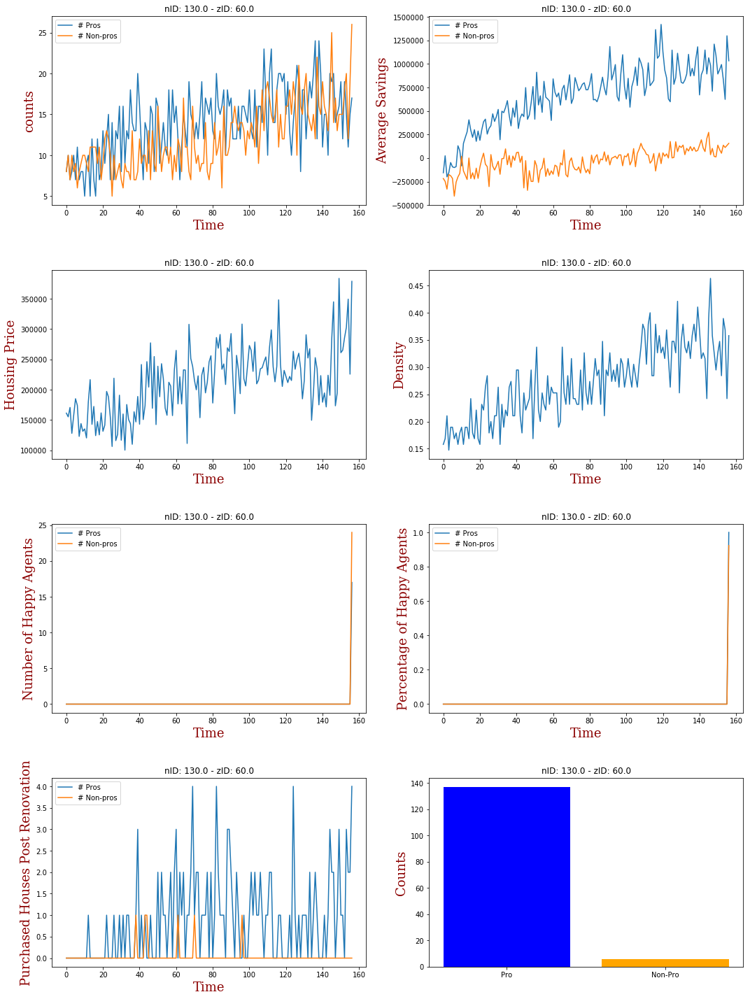

In [34]:
font = {'family': 'serif',
        'color':  'darkred',
        'weight': 'normal',
        'size': 18,
        }

features = ['counts', 'housing']
for feature in features:
    if not os.path.exists('plots/nID/{}/'.format(feature)):
        os.makedirs('plots/nID/{}/'.format(feature))

for key in sorted(stat_pro):
    plt.clf()

    n = max(max([t['tick'] for t in stat_pro[key]]), max([t['tick'] for t in stat_nonpro[key]]))
    zID = merged[merged.nID==key]['zID'].values[0]
    fig = plt.figure(figsize=(15,20))
    
    feature = 'counts'
    ax = fig.add_subplot(4,2,1)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    for t in stat_pro[key]:
        f_pro[t['tick']-1] = t[feature]
    for t in stat_nonpro[key]:
        f_nonpro[t['tick']-1] = t[feature]
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    # moved nonpros
    ax.legend(['# Pros', '# Non-pros'])
    ax.set_xlabel('Time',fontdict=font)
    ax.set_ylabel(feature,fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))
    
    feature = 'avg_savings'
    ax = fig.add_subplot(4,2,2)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    for t in stat_pro[key]:
        f_pro[t['tick']-1] = t[feature]
    for t in stat_nonpro[key]:
        f_nonpro[t['tick']-1] = t[feature]
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    ax.legend(['# Pros', '# Non-pros'])
    ax.set_xlabel('Time',fontdict=font)
    ax.set_ylabel('Average Savings',fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    feature = 'housing_price'
    ax = fig.add_subplot(4,2,3)
    p_info = np.zeros((n))
    for t in patch_info[key]:
        p_info[t['tick']-1] = t[feature]
    ax.plot(range(n), p_info)
    ax.set_xlabel('Time',fontdict=font)
    ax.set_ylabel('Housing Price', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    feature = 'density'
    ax = fig.add_subplot(4,2,4)
    p_info = np.zeros((n))
    for t in patch_info[key]:
        p_info[t['tick']-1] = t[feature]
    ax.plot(range(n), p_info)
    ax.set_xlabel('Time',fontdict=font)
    ax.set_ylabel('Density', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    feature = 'nhappy'
    ax = fig.add_subplot(4,2,5)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    for t in stat_pro[key]:
        f_pro[t['tick']-1] = t[feature]
    for t in stat_nonpro[key]:
        f_nonpro[t['tick']-1] = t[feature]
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    ax.legend(['# Pros', '# Non-pros'])
    ax.set_xlabel('Time',fontdict=font)
    ax.set_ylabel('Number of Happy Agents', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    feature = 'percentage_happy'
    ax = fig.add_subplot(4,2,6)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    for t in stat_pro[key]:
        f_pro[t['tick']-1] = t[feature]
    for t in stat_nonpro[key]:
        f_nonpro[t['tick']-1] = t[feature]
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    ax.legend(['# Pros', '# Non-pros'])
    ax.set_xlabel('Time',fontdict=font)
    ax.set_ylabel('Percentage of Happy Agents', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    ax = fig.add_subplot(4,2,7)
    f_pro = np.zeros((n))
    f_nonpro = np.zeros((n))
    if key in pros_bought_house_by_nid:
        for t,v in pros_bought_house_by_nid[key].items():
            f_pro[int(t)-1] = v
    if key in nonpros_bought_house_by_nid:
        for t,v in nonpros_bought_house_by_nid[key].items():
            f_nonpro[int(t)-1] = v
    ax.plot(range(n), f_pro)
    ax.plot(range(n), f_nonpro)
    ax.legend(['# Pros', '# Non-pros'])
    ax.set_xlabel('Time',fontdict=font)
    ax.set_ylabel('Purchased Houses Post Renovation', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    ax = fig.add_subplot(4,2,8)
    f_pro = np.sum(f_pro)
    f_nonpro = np.sum(f_nonpro)
    ax.bar([0,1], [f_pro, f_nonpro], color=('blue', 'orange'))
    ax.set_xticks([0,1])
    ax.set_xticklabels(('Pro', 'Non-Pro'))
    ax.set_ylabel('Counts', fontdict=font)
    ax.set_title('nID: {} - zID: {}'.format(key, zID))

    plt.tight_layout()
    plt.savefig('plots/nID/{}-{}.png'.format(zID, key))
    plt.show()